In [50]:
import xarray as xr
from glob import glob 
import numpy as np
import pandas as pd 
datas = glob("../data/DVI_2015/*hdf")
dfs = []
months = {'01':'January','02':'Feburary','03':'March','04':'April','05':'May',
        '06':'June','07':'July','08' :'August','09':'September','10':'October',
        '11':'November','12':'December'}

for data in datas:
    ds = xr.open_dataset(data, engine='netcdf4')
    df = ds.to_dataframe().reset_index()
    df['ydim'] = df['ydim'].astype('float') 
    df['xdim'] = df['xdim'].astype('float') 
    df['ydim'] = df['ydim'] - (np.max(df['ydim'])/2)
    df['ydim'] = df['ydim']*-1
    df['xdim'] = df['xdim'] - (np.max(df['xdim'])/2)
    month = months[data.split('/')[-1].split('.')[1].replace('2015', '')]
    df['month'] = month
    dfs.append(df)
df = pd.concat(dfs)
df.head()

/Users/nathan/opt/anaconda3/envs/playground/lib/python3.9/site-packages/xarray/coding/variables.py:141: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



,xdim,ydim,NDVI,EVI,perc_fill_value,perc_good_pixels,month
0,-179.5,89.5,NaN,NaN,100.0,0.0,November
1,-179.5,88.5,NaN,NaN,100.0,0.0,November
2,-179.5,87.5,NaN,NaN,100.0,0.0,November
3,-179.5,86.5,NaN,NaN,100.0,0.0,November
4,-179.5,85.5,NaN,NaN,100.0,0.0,November


In [73]:
import os, sys
sys.path.append('../')
from data_functions import degree2radians, mapping_map_to_sphere, process_df, get_XYZV, create_spherical_heatmap_vals, get_lines

tdf = process_df(df, None, 'ydim', 'xdim')
tdf.sample(10)

In [56]:
XXs = {}
YYs = {}
ZZs = {}
WWs = {}

for k, month in months.items():
    xyzv = get_XYZV(tdf[tdf['month'] == month ], 'NDVI')
    XX, YY, ZZ, WW = create_spherical_heatmap_vals(xyzv, num_samples=100)
    XXs[month] = XX
    YYs[month] = YY
    ZZs[month] = ZZ
    WWs[month] = WW

(100, 100)

In [78]:
import cartopy.feature as cf
import plotly.graph_objects as go

month_sliders = []
border_sliders = []

for k, month in months.items():
    XX=XXs[month]
    YY=YYs[month]
    ZZ=ZZs[month]
    WW=WWs[month]

    month_sliders.append(go.Surface(x=XX, y=YY, z=ZZ, colorscale='Greens', surfacecolor=WW, opacity=1, visible=False, cmin=0, cmax=1))
    borders = [get_lines(g) for g in [cf.COASTLINE.geometries, cf.BORDERS.geometries] ]
    bx, by, bz = np.concatenate(borders, axis=1)
    border_sliders.append(go.Scatter3d(x=bx, y=by, z=bz, showlegend=False, hoverinfo='skip', mode='lines', visible=False, line = dict(color='black', width=4)))


fig = go.Figure(data=month_sliders+border_sliders)


steps = []
for i, (k,month) in enumerate(months.items()):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Month: " + str(month)}],
              label=str(month)  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    step['args'][0]['visible'][i+len(months)] = True

    steps.append(step)

sliders = [dict(
    active=len(months),
    currentvalue={"prefix": "Steps: "},
    pad={"t": 50},
    steps=steps,
)]

fig.update_layout(
    sliders=sliders
)

for x,y,z in [get_lines(g) for g in [cf.COASTLINE.geometries, cf.BORDERS.geometries] ]:
    fig.add_trace(go.Scatter3d(x=x, y=y, z=z, showlegend=False, hoverinfo='skip', mode='lines', line = dict(color='black', width=4)))


fig.data[0].visible = True
fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )

### buttons

# Add drowdowns
# button_layer_1_height = 1.08
button_layer_1_height = 1.12
button_layer_2_height = 1.065

fig.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["colorscale", "Greens"],
                    label="Greens",
                    method="restyle"
                ),
                dict(
                    args=["colorscale", "Viridis"],
                    label="Viridis",
                    method="restyle"
                ),
                dict(
                    args=["colorscale", "Cividis"],
                    label="Cividis",
                    method="restyle"
                ),
                dict(
                    args=["colorscale", "Blues"],
                    label="Blues",
                    method="restyle"
                ),

            ]),
            type = "buttons",
            direction="right",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        ),
        dict(
            buttons=list([
                dict(
                    args=["reversescale", False],
                    label="False",
                    method="restyle"
                ),
                dict(
                    args=["reversescale", True],
                    label="True",
                    method="restyle"
                )
            ]),
            type = "buttons",
            direction="right",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.13,
            xanchor="left",
            y=button_layer_2_height,
            yanchor="top"
        )
    ]
)

fig.update_layout(
    annotations=[
        dict(text="colorscale", x=0, xref="paper", y=1.1, yref="paper",
                             align="left", showarrow=False),
        dict(text="Reverse<br>Colorscale", x=0, xref="paper", y=1.06,
                             yref="paper", showarrow=False),
        dict(text="Lines", x=0.47, xref="paper", y=1.045, yref="paper",
                             showarrow=False)
    ])


###


fig.show()
fig.write_html("../plots/coloured_NDVI_OT.html")

In [48]:
import cartopy.feature as cf
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(x=XX, y=YY, z=ZZ, colorscale='speed', surfacecolor=WW, opacity=1)] )

#fig = go.Figure(data=[go.Scatter3d(x=xyzv[:,0], y=xyzv[:,1],z=xyzv[:,2], mode='markers')])

for x,y,z in [get_lines(g) for g in [cf.COASTLINE.geometries, cf.BORDERS.geometries] ]:
    fig.add_trace(go.Scatter3d(x=x, y=y, z=z, showlegend=False, hoverinfo='skip', mode='lines', line = dict(color='black', width=4)))

#fig.add_trace(go.Scatter3d(x=xyzv[:,0], y=xyzv[:,1],z=xyzv[:,2], mode='markers'))


fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )

#scale_lst = [[*row] for row in fig.data[0].colorscale]
# edit the color for the lowest value
#scale_lst[0][1] = '#02345C'
# turn edited list back into a tuple
#scale_tup = tuple(tuple(i) for i in scale_lst)
# replace the original tuple
#fig.data[0].colorscale = scale_tup

fig.show()
fig.write_html("../plots/coloured_NDVI.html")

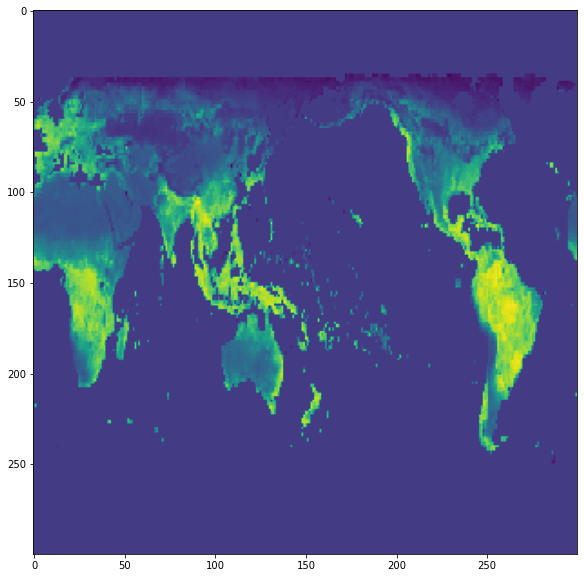

In [16]:
import matplotlib.pyplot as plt 
fig, ax = plt.subplots(1, figsize=(10,10))
ax.imshow(np.roll(WW.T, 10))